In [1]:
# Load libraries
import yfinance as yf
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
from pandas import read_csv, set_option
from pandas.plotting import scatter_matrix
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from datetime import date

#Import Model Packages 
import scipy.cluster.hierarchy as sch
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import fcluster
from scipy.cluster.hierarchy import dendrogram, linkage, cophenet
from sklearn.metrics import adjusted_mutual_info_score
from sklearn import cluster, covariance, manifold
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE


#Package for optimization of mean variance optimization
import cvxopt as opt
from cvxopt import blas, solvers

#network diagrams
import networkx as nx

In [2]:
dates = pd.read_csv("dates.csv")

In [7]:
erc = pd.read_csv("erc.csv")
erc = erc.rename({'Unnamed: 0': ''}, axis=1)  # new method
erc = erc.set_index('')
erc = erc.T
erc = erc.reindex(sorted(erc.columns), axis=1)
erc.index = erc.index.astype(int)
erc.index = dates.Date[252-1:]

In [8]:
import plotly.graph_objects as go

x=erc.index
data=erc
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=x, y=data.Alibaba,
    mode='lines',
    line=dict(width=0.5, color='rgb(184, 247, 212)'),
    stackgroup='one',
    groupnorm='percent' # sets the normalization for the sum of the stackgroup
))


fig.add_trace(go.Scatter(
    x=x, y=data.BASF,
    mode='lines',
    line=dict(width=0.5, color='rgb(111, 231, 219)'),
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.BHPB,
    mode='lines',
    line=dict(width=0.5, color='rgb(127, 166, 238)'),
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.BankChina,
    mode='lines',
    line=dict(width=0.5, color='rgb(131, 90, 241)'),
    #label="Bank of China",
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.CocaCola,
    mode='lines',
    line=dict(width=0.5, color='rgb(72,209,204)'),
    stackgroup='one'
))


fig.add_trace(go.Scatter(
    x=x, y=data.Medtronic,
    mode='lines',
    line=dict(width=0.5, color='rgb(175,238,238)'),
    stackgroup='one'
))


fig.add_trace(go.Scatter(
    x=x, y=data.PG,
    mode='lines',
    line=dict(width=0.5, color='rgb(176,224,230)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.RTX,
    mode='lines',
    line=dict(width=0.5, color='rgb(95,158,160)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.SAP,
    mode='lines',
    line=dict(width=0.5, color='rgb(70,130,180)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Samsung,
    mode='lines',
    line=dict(width=0.5, color='rgb(100,149,237)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Sanofi,
    mode='lines',
    line=dict(width=0.5, color='rgb(0,191,255)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Schneider,
    mode='lines',
    line=dict(width=0.5, color='rgb(30,144,255)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Shell,
    mode='lines',
    line=dict(width=0.5, color='rgb(173,216,230)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Sony,
    mode='lines',
    line=dict(width=0.5, color='rgb(135,206,235)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.VW,
    mode='lines',
    line=dict(width=0.5, color='rgb(135,206,250)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Vodafone,
    mode='lines',
    line=dict(width=0.5, color='rgb(32,178,170)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Walmart,
    mode='lines',
    line=dict(width=0.5, color='rgb(0,139,139)'),
    stackgroup='one'
))

fig.update_layout(
    showlegend=False,
    title="ERC",
    xaxis_type=None,#'category',
    yaxis=dict(
        type='linear',
        range=[1, 100],
        ticksuffix='%'))

fig.show()

In [9]:
hra = pd.read_csv("hra.csv")
hra = hra.rename({'Unnamed: 0': ''}, axis=1)  # new method
hra = hra.set_index('')
hra = hra.T
hra = hra.reindex(sorted(hra.columns), axis=1)
hra.index = hra.index.astype(int)
hra.index = dates.Date[252-1:]

In [10]:
import plotly.graph_objects as go

x=hra.index
data=hra
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=x, y=data.Alibaba,
    mode='lines',
    line=dict(width=0.5, color='rgb(184, 247, 212)'),
    stackgroup='one',
    groupnorm='percent' # sets the normalization for the sum of the stackgroup
))


fig.add_trace(go.Scatter(
    x=x, y=data.BASF,
    mode='lines',
    line=dict(width=0.5, color='rgb(111, 231, 219)'),
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.BHPB,
    mode='lines',
    line=dict(width=0.5, color='rgb(127, 166, 238)'),
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.BankChina,
    mode='lines',
    line=dict(width=0.5, color='rgb(131, 90, 241)'),
    #label="Bank of China",
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.CocaCola,
    mode='lines',
    line=dict(width=0.5, color='rgb(72,209,204)'),
    stackgroup='one'
))


fig.add_trace(go.Scatter(
    x=x, y=data.Medtronic,
    mode='lines',
    line=dict(width=0.5, color='rgb(175,238,238)'),
    stackgroup='one'
))


fig.add_trace(go.Scatter(
    x=x, y=data.PG,
    mode='lines',
    line=dict(width=0.5, color='rgb(176,224,230)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.RTX,
    mode='lines',
    line=dict(width=0.5, color='rgb(95,158,160)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.SAP,
    mode='lines',
    line=dict(width=0.5, color='rgb(70,130,180)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Samsung,
    mode='lines',
    line=dict(width=0.5, color='rgb(100,149,237)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Sanofi,
    mode='lines',
    line=dict(width=0.5, color='rgb(0,191,255)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Schneider,
    mode='lines',
    line=dict(width=0.5, color='rgb(30,144,255)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Shell,
    mode='lines',
    line=dict(width=0.5, color='rgb(173,216,230)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Sony,
    mode='lines',
    line=dict(width=0.5, color='rgb(135,206,235)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.VW,
    mode='lines',
    line=dict(width=0.5, color='rgb(135,206,250)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Vodafone,
    mode='lines',
    line=dict(width=0.5, color='rgb(32,178,170)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Walmart,
    mode='lines',
    line=dict(width=0.5, color='rgb(0,139,139)'),
    stackgroup='one'
))

fig.update_layout(
    showlegend=False,
    title="HRA",
    xaxis_type=None,#'category',
    yaxis=dict(
        type='linear',
        range=[1, 100],
        ticksuffix='%'))

fig.show()

In [19]:
pca = pd.read_csv("pca.csv")
pca = pca.rename({'Unnamed: 0': ''}, axis=1)  # new method
pca = pca.set_index('')
pca = pca.T
pca = pca.reindex(sorted(pca.columns), axis=1)
#pca.index = hra.index.astype(int)
pca.index = dates.Date[252-1:]

In [20]:
import plotly.graph_objects as go

x=pca.index
data=pca
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=x, y=data.Alibaba,
    mode='lines',
    line=dict(width=0.5, color='rgb(184, 247, 212)'),
    stackgroup='one',
    groupnorm='percent' # sets the normalization for the sum of the stackgroup
))


fig.add_trace(go.Scatter(
    x=x, y=data.BASF,
    mode='lines',
    line=dict(width=0.5, color='rgb(111, 231, 219)'),
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.BHPB,
    mode='lines',
    line=dict(width=0.5, color='rgb(127, 166, 238)'),
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.BankChina,
    mode='lines',
    line=dict(width=0.5, color='rgb(131, 90, 241)'),
    #label="Bank of China",
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.CocaCola,
    mode='lines',
    line=dict(width=0.5, color='rgb(72,209,204)'),
    stackgroup='one'
))


fig.add_trace(go.Scatter(
    x=x, y=data.Medtronic,
    mode='lines',
    line=dict(width=0.5, color='rgb(175,238,238)'),
    stackgroup='one'
))


fig.add_trace(go.Scatter(
    x=x, y=data.PG,
    mode='lines',
    line=dict(width=0.5, color='rgb(176,224,230)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.RTX,
    mode='lines',
    line=dict(width=0.5, color='rgb(95,158,160)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.SAP,
    mode='lines',
    line=dict(width=0.5, color='rgb(70,130,180)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Samsung,
    mode='lines',
    line=dict(width=0.5, color='rgb(100,149,237)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Sanofi,
    mode='lines',
    line=dict(width=0.5, color='rgb(0,191,255)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Schneider,
    mode='lines',
    line=dict(width=0.5, color='rgb(30,144,255)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Shell,
    mode='lines',
    line=dict(width=0.5, color='rgb(173,216,230)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Sony,
    mode='lines',
    line=dict(width=0.5, color='rgb(135,206,235)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.VW,
    mode='lines',
    line=dict(width=0.5, color='rgb(135,206,250)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Vodafone,
    mode='lines',
    line=dict(width=0.5, color='rgb(32,178,170)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Walmart,
    mode='lines',
    line=dict(width=0.5, color='rgb(0,139,139)'),
    stackgroup='one'
))

fig.update_layout(
    showlegend=False,
    title="PCA",
    xaxis_type=None,#'category',
    yaxis=dict(
        type='linear',
        range=[1, 100],
        ticksuffix='%'))

fig.show()

In [5]:
ew = pd.read_csv("ew.csv")
ew = ew.rename({'Unnamed: 0': ''}, axis=1)  # new method
ew = ew.set_index('')
ew = ew.T
ew = ew.reindex(sorted(ew.columns), axis=1)
ew.index = ew.index.astype(int)
ew.index = dates.Date[252-1:]

In [6]:
import plotly.graph_objects as go

x=ew.index
data=ew
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=x, y=data.Alibaba,
    mode='lines',
    line=dict(width=0.5, color='rgb(184, 247, 212)'),
    stackgroup='one',
    groupnorm='percent' # sets the normalization for the sum of the stackgroup
))


fig.add_trace(go.Scatter(
    x=x, y=data.BASF,
    mode='lines',
    line=dict(width=0.5, color='rgb(111, 231, 219)'),
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.BHPB,
    mode='lines',
    line=dict(width=0.5, color='rgb(127, 166, 238)'),
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.BankChina,
    mode='lines',
    line=dict(width=0.5, color='rgb(131, 90, 241)'),
    #label="Bank of China",
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.CocaCola,
    mode='lines',
    line=dict(width=0.5, color='rgb(72,209,204)'),
    stackgroup='one'
))


fig.add_trace(go.Scatter(
    x=x, y=data.Medtronic,
    mode='lines',
    line=dict(width=0.5, color='rgb(175,238,238)'),
    stackgroup='one'
))


fig.add_trace(go.Scatter(
    x=x, y=data.PG,
    mode='lines',
    line=dict(width=0.5, color='rgb(176,224,230)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.RTX,
    mode='lines',
    line=dict(width=0.5, color='rgb(95,158,160)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.SAP,
    mode='lines',
    line=dict(width=0.5, color='rgb(70,130,180)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Samsung,
    mode='lines',
    line=dict(width=0.5, color='rgb(100,149,237)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Sanofi,
    mode='lines',
    line=dict(width=0.5, color='rgb(0,191,255)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Schneider,
    mode='lines',
    line=dict(width=0.5, color='rgb(30,144,255)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Shell,
    mode='lines',
    line=dict(width=0.5, color='rgb(173,216,230)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Sony,
    mode='lines',
    line=dict(width=0.5, color='rgb(135,206,235)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.VW,
    mode='lines',
    line=dict(width=0.5, color='rgb(135,206,250)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Vodafone,
    mode='lines',
    line=dict(width=0.5, color='rgb(32,178,170)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Walmart,
    mode='lines',
    line=dict(width=0.5, color='rgb(0,139,139)'),
    stackgroup='one'
))

fig.update_layout(
    showlegend=False,
    title="EW",
    xaxis_type=None,#'category',
    yaxis=dict(
        type='linear',
        range=[1, 100],
        ticksuffix='%'))

fig.show()

In [83]:
hcaa = pd.read_csv("hcaa.csv")
hcaa = hcaa.rename({'Unnamed: 0': ''}, axis=1)  # new method
hcaa = hcaa.set_index('')
hcaa = hcaa.T
hcaa = hcaa.reindex(sorted(hcaa.columns), axis=1)
hcaa.index = hcaa.index.astype(int)
#hcaa.index = dates.Date[252-1:]

In [84]:
hcaa.index = dates.Date[252-1:]

ValueError: Length mismatch: Expected axis has 1386 elements, new values have 8308 elements

In [ ]:
import plotly.graph_objects as go

x=hcaa.index
data=hcaa
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=x, y=data.Alibaba,
    mode='lines',
    line=dict(width=0.5, color='rgb(184, 247, 212)'),
    stackgroup='one',
    groupnorm='percent' # sets the normalization for the sum of the stackgroup
))


fig.add_trace(go.Scatter(
    x=x, y=data.BASF,
    mode='lines',
    line=dict(width=0.5, color='rgb(111, 231, 219)'),
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.BHPB,
    mode='lines',
    line=dict(width=0.5, color='rgb(127, 166, 238)'),
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.BankChina,
    mode='lines',
    line=dict(width=0.5, color='rgb(131, 90, 241)'),
    #label="Bank of China",
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.CocaCola,
    mode='lines',
    line=dict(width=0.5, color='rgb(72,209,204)'),
    stackgroup='one'
))


fig.add_trace(go.Scatter(
    x=x, y=data.Medtronic,
    mode='lines',
    line=dict(width=0.5, color='rgb(175,238,238)'),
    stackgroup='one'
))


fig.add_trace(go.Scatter(
    x=x, y=data.PG,
    mode='lines',
    line=dict(width=0.5, color='rgb(176,224,230)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.RTX,
    mode='lines',
    line=dict(width=0.5, color='rgb(95,158,160)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.SAP,
    mode='lines',
    line=dict(width=0.5, color='rgb(70,130,180)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Samsung,
    mode='lines',
    line=dict(width=0.5, color='rgb(100,149,237)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Sanofi,
    mode='lines',
    line=dict(width=0.5, color='rgb(0,191,255)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Schneider,
    mode='lines',
    line=dict(width=0.5, color='rgb(30,144,255)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Shell,
    mode='lines',
    line=dict(width=0.5, color='rgb(173,216,230)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Sony,
    mode='lines',
    line=dict(width=0.5, color='rgb(135,206,235)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.VW,
    mode='lines',
    line=dict(width=0.5, color='rgb(135,206,250)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Vodafone,
    mode='lines',
    line=dict(width=0.5, color='rgb(32,178,170)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Walmart,
    mode='lines',
    line=dict(width=0.5, color='rgb(0,139,139)'),
    stackgroup='one'
))

fig.update_layout(
    showlegend=False,
    title="HCAA",
    xaxis_type=None,#'category',
    yaxis=dict(
        type='linear',
        range=[1, 100],
        ticksuffix='%'))

fig.show()

In [12]:
herc = pd.read_csv("herc.csv")
herc = herc.rename({'Unnamed: 0': ''}, axis=1)  # new method
herc = herc.set_index('')
herc = herc.T
herc = herc.reindex(sorted(herc.columns), axis=1)
herc.index = herc.index.astype(int)
herc.index = dates.Date[252-1:]

In [13]:
import plotly.graph_objects as go

x=herc.index
data=herc
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=x, y=data.Alibaba,
    mode='lines',
    line=dict(width=0.5, color='rgb(184, 247, 212)'),
    stackgroup='one',
    groupnorm='percent' # sets the normalization for the sum of the stackgroup
))


fig.add_trace(go.Scatter(
    x=x, y=data.BASF,
    mode='lines',
    line=dict(width=0.5, color='rgb(111, 231, 219)'),
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.BHPB,
    mode='lines',
    line=dict(width=0.5, color='rgb(127, 166, 238)'),
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.BankChina,
    mode='lines',
    line=dict(width=0.5, color='rgb(131, 90, 241)'),
    #label="Bank of China",
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.CocaCola,
    mode='lines',
    line=dict(width=0.5, color='rgb(72,209,204)'),
    stackgroup='one'
))


fig.add_trace(go.Scatter(
    x=x, y=data.Medtronic,
    mode='lines',
    line=dict(width=0.5, color='rgb(175,238,238)'),
    stackgroup='one'
))


fig.add_trace(go.Scatter(
    x=x, y=data.PG,
    mode='lines',
    line=dict(width=0.5, color='rgb(176,224,230)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.RTX,
    mode='lines',
    line=dict(width=0.5, color='rgb(95,158,160)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.SAP,
    mode='lines',
    line=dict(width=0.5, color='rgb(70,130,180)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Samsung,
    mode='lines',
    line=dict(width=0.5, color='rgb(100,149,237)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Sanofi,
    mode='lines',
    line=dict(width=0.5, color='rgb(0,191,255)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Schneider,
    mode='lines',
    line=dict(width=0.5, color='rgb(30,144,255)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Shell,
    mode='lines',
    line=dict(width=0.5, color='rgb(173,216,230)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Sony,
    mode='lines',
    line=dict(width=0.5, color='rgb(135,206,235)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.VW,
    mode='lines',
    line=dict(width=0.5, color='rgb(135,206,250)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Vodafone,
    mode='lines',
    line=dict(width=0.5, color='rgb(32,178,170)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Walmart,
    mode='lines',
    line=dict(width=0.5, color='rgb(0,139,139)'),
    stackgroup='one'
))

fig.update_layout(
    showlegend=False,
    title="HERC",
    xaxis_type=None,#'category',
    yaxis=dict(
        type='linear',
        range=[1, 100],
        ticksuffix='%'))

fig.show()

In [14]:
hrpw = pd.read_csv("hrpw.csv")
hrpw = hrpw.rename({'Unnamed: 0': ''}, axis=1)  # new method
hrpw = hrpw.set_index('')
hrpw = hrpw.T
hrpw = hrpw.reindex(sorted(hrpw.columns), axis=1)
hrpw.index = hrpw.index.astype(int)
hrpw.index = dates.Date[252-1:]

In [15]:
import plotly.graph_objects as go

x=herc.index
data=hrpw
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=x, y=data.Alibaba,
    mode='lines',
    line=dict(width=0.5, color='rgb(184, 247, 212)'),
    stackgroup='one',
    groupnorm='percent' # sets the normalization for the sum of the stackgroup
))


fig.add_trace(go.Scatter(
    x=x, y=data.BASF,
    mode='lines',
    line=dict(width=0.5, color='rgb(111, 231, 219)'),
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.BHPB,
    mode='lines',
    line=dict(width=0.5, color='rgb(127, 166, 238)'),
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.BankChina,
    mode='lines',
    line=dict(width=0.5, color='rgb(131, 90, 241)'),
    #label="Bank of China",
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.CocaCola,
    mode='lines',
    line=dict(width=0.5, color='rgb(72,209,204)'),
    stackgroup='one'
))


fig.add_trace(go.Scatter(
    x=x, y=data.Medtronic,
    mode='lines',
    line=dict(width=0.5, color='rgb(175,238,238)'),
    stackgroup='one'
))


fig.add_trace(go.Scatter(
    x=x, y=data.PG,
    mode='lines',
    line=dict(width=0.5, color='rgb(176,224,230)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.RTX,
    mode='lines',
    line=dict(width=0.5, color='rgb(95,158,160)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.SAP,
    mode='lines',
    line=dict(width=0.5, color='rgb(70,130,180)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Samsung,
    mode='lines',
    line=dict(width=0.5, color='rgb(100,149,237)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Sanofi,
    mode='lines',
    line=dict(width=0.5, color='rgb(0,191,255)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Schneider,
    mode='lines',
    line=dict(width=0.5, color='rgb(30,144,255)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Shell,
    mode='lines',
    line=dict(width=0.5, color='rgb(173,216,230)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Sony,
    mode='lines',
    line=dict(width=0.5, color='rgb(135,206,235)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.VW,
    mode='lines',
    line=dict(width=0.5, color='rgb(135,206,250)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Vodafone,
    mode='lines',
    line=dict(width=0.5, color='rgb(32,178,170)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Walmart,
    mode='lines',
    line=dict(width=0.5, color='rgb(0,139,139)'),
    stackgroup='one'
))

fig.update_layout(
    showlegend=False,
    title="HRP",
    xaxis_type=None,#'category',
    yaxis=dict(
        type='linear',
        range=[1, 100],
        ticksuffix='%'))

fig.show()

In [16]:
ivp = pd.read_csv("ivp.csv")
ivp = ivp.rename({'Unnamed: 0': ''}, axis=1)  # new method
ivp = ivp.set_index('')
ivp = ivp.T
ivp = ivp.reindex(sorted(ivp.columns), axis=1)
ivp.index = ivp.index.astype(int)
ivp.index = dates.Date[252-1:]

In [17]:
import plotly.graph_objects as go

x=herc.index
data=ivp
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=x, y=data.Alibaba,
    mode='lines',
    line=dict(width=0.5, color='rgb(184, 247, 212)'),
    stackgroup='one',
    groupnorm='percent' # sets the normalization for the sum of the stackgroup
))


fig.add_trace(go.Scatter(
    x=x, y=data.BASF,
    mode='lines',
    line=dict(width=0.5, color='rgb(111, 231, 219)'),
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.BHPB,
    mode='lines',
    line=dict(width=0.5, color='rgb(127, 166, 238)'),
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.BankChina,
    mode='lines',
    line=dict(width=0.5, color='rgb(131, 90, 241)'),
    #label="Bank of China",
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.CocaCola,
    mode='lines',
    line=dict(width=0.5, color='rgb(72,209,204)'),
    stackgroup='one'
))


fig.add_trace(go.Scatter(
    x=x, y=data.Medtronic,
    mode='lines',
    line=dict(width=0.5, color='rgb(175,238,238)'),
    stackgroup='one'
))


fig.add_trace(go.Scatter(
    x=x, y=data.PG,
    mode='lines',
    line=dict(width=0.5, color='rgb(176,224,230)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.RTX,
    mode='lines',
    line=dict(width=0.5, color='rgb(95,158,160)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.SAP,
    mode='lines',
    line=dict(width=0.5, color='rgb(70,130,180)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Samsung,
    mode='lines',
    line=dict(width=0.5, color='rgb(100,149,237)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Sanofi,
    mode='lines',
    line=dict(width=0.5, color='rgb(0,191,255)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Schneider,
    mode='lines',
    line=dict(width=0.5, color='rgb(30,144,255)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Shell,
    mode='lines',
    line=dict(width=0.5, color='rgb(173,216,230)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Sony,
    mode='lines',
    line=dict(width=0.5, color='rgb(135,206,235)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.VW,
    mode='lines',
    line=dict(width=0.5, color='rgb(135,206,250)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Vodafone,
    mode='lines',
    line=dict(width=0.5, color='rgb(32,178,170)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Walmart,
    mode='lines',
    line=dict(width=0.5, color='rgb(0,139,139)'),
    stackgroup='one'
))

fig.update_layout(
    showlegend=False,
    title="IVP",
    xaxis_type=None,#'category',
    yaxis=dict(
        type='linear',
        range=[1, 100],
        ticksuffix='%'))

fig.show()

In [18]:
mvp = pd.read_csv("mvp.csv")
mvp = mvp.rename({'Unnamed: 0': ''}, axis=1)  # new method
mvp = mvp.set_index('')
mvp = mvp.T
mvp = mvp.reindex(sorted(mvp.columns), axis=1)
mvp.index = mvp.index.astype(int)
mvp.index = dates.Date[252-1:]

In [19]:
import plotly.graph_objects as go

x=herc.index
data=mvp
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=x, y=data.Alibaba,
    mode='lines',
    line=dict(width=0.5, color='rgb(184, 247, 212)'),
    stackgroup='one',
    groupnorm='percent' # sets the normalization for the sum of the stackgroup
))


fig.add_trace(go.Scatter(
    x=x, y=data.BASF,
    mode='lines',
    line=dict(width=0.5, color='rgb(111, 231, 219)'),
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.BHPB,
    mode='lines',
    line=dict(width=0.5, color='rgb(127, 166, 238)'),
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.BankChina,
    mode='lines',
    line=dict(width=0.5, color='rgb(131, 90, 241)'),
    #label="Bank of China",
    stackgroup='one'
))

fig.add_trace(go.Scatter(
    x=x, y=data.CocaCola,
    mode='lines',
    line=dict(width=0.5, color='rgb(72,209,204)'),
    stackgroup='one'
))


fig.add_trace(go.Scatter(
    x=x, y=data.Medtronic,
    mode='lines',
    line=dict(width=0.5, color='rgb(175,238,238)'),
    stackgroup='one'
))


fig.add_trace(go.Scatter(
    x=x, y=data.PG,
    mode='lines',
    line=dict(width=0.5, color='rgb(176,224,230)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.RTX,
    mode='lines',
    line=dict(width=0.5, color='rgb(95,158,160)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.SAP,
    mode='lines',
    line=dict(width=0.5, color='rgb(70,130,180)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Samsung,
    mode='lines',
    line=dict(width=0.5, color='rgb(100,149,237)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Sanofi,
    mode='lines',
    line=dict(width=0.5, color='rgb(0,191,255)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Schneider,
    mode='lines',
    line=dict(width=0.5, color='rgb(30,144,255)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Shell,
    mode='lines',
    line=dict(width=0.5, color='rgb(173,216,230)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Sony,
    mode='lines',
    line=dict(width=0.5, color='rgb(135,206,235)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.VW,
    mode='lines',
    line=dict(width=0.5, color='rgb(135,206,250)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Vodafone,
    mode='lines',
    line=dict(width=0.5, color='rgb(32,178,170)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=data.Walmart,
    mode='lines',
    line=dict(width=0.5, color='rgb(0,139,139)'),
    stackgroup='one'
))

fig.update_layout(
    showlegend=False,
    title="MVP",
    xaxis_type=None,#'category',
    yaxis=dict(
        type='linear',
        range=[1, 100],
        ticksuffix='%'))

fig.show()

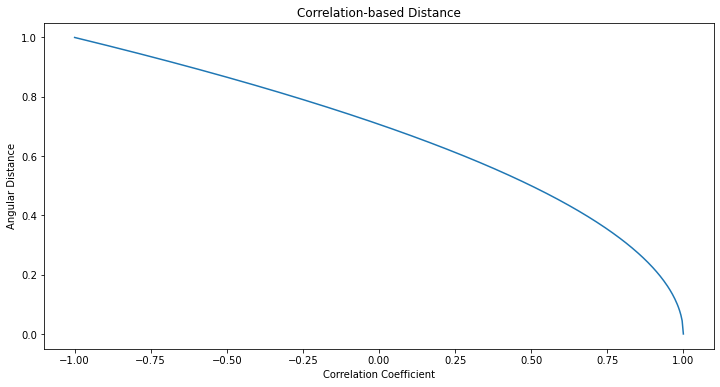

In [20]:
r = np.linspace(-1,1,500)
d = np.sqrt(0.5*(1-r))

plt.figure(figsize=(12,6))
plt.title('Correlation-based Distance')
plt.xlabel('Correlation Coefficient')
plt.ylabel('Angular Distance')
plt.plot(r,d)
plt.show()

In [2]:
dist = pd.read_csv("dist_matrix.csv")

In [3]:
dist.set_index("Unnamed: 0", inplace=True)
dist

,Samsung,BankChina,Sony,Alibaba,BASF,BHPB,CocaCola,Medtronic,PG,Shell,RTX,SAP,Sanofi,Schneider,Vodafone,VW,Walmart
Unnamed: 0,,,,,,,,,,,,,,,,,
Samsung,0.000000,0.656217,0.614851,0.660924,0.664090,0.641343,0.706004,0.689122,0.714742,0.672210,0.689726,0.659270,0.688298,0.664618,0.658889,0.662334,0.693780
BankChina,0.656217,0.000000,0.670490,0.679071,0.673142,0.646564,0.684589,0.682652,0.695516,0.672341,0.683868,0.679019,0.680027,0.661923,0.671357,0.684123,0.697343
Sony,0.614851,0.670490,0.000000,0.674469,0.629104,0.640442,0.661058,0.651866,0.679648,0.628606,0.650823,0.622182,0.632502,0.622067,0.645670,0.626561,0.683530
Alibaba,0.660924,0.679071,0.674469,0.000000,0.585237,0.593902,0.630343,0.569778,0.615823,0.603850,0.587476,0.590126,0.614956,0.590179,0.601243,0.593963,0.650730
BASF,0.664090,0.673142,0.629104,0.585237,0.000000,0.514129,0.647054,0.635712,0.646249,0.494037,0.575693,0.546093,0.540003,0.491133,0.578325,0.531433,0.651689
BHPB,0.641343,0.646564,0.640442,0.593902,0.514129,0.000000,0.659623,0.654220,0.667326,0.504715,0.592491,0.600119,0.598353,0.524631,0.596410,0.581875,0.664997
CocaCola,0.706004,0.684589,0.661058,0.630343,0.647054,0.659623,0.000000,0.595681,0.529131,0.660374,0.574469,0.679688,0.652794,0.648018,0.680381,0.649664,0.573796
Medtronic,0.689122,0.682652,0.651866,0.569778,0.635712,0.654220,0.595681,0.000000,0.601661,0.647896,0.581519,0.644190,0.640502,0.636399,0.655325,0.641564,0.602457
PG,0.714742,0.695516,0.679648,0.615823,0.646249,0.667326,0.529131,0.601661,0.000000,0.663745,0.576973,0.687212,0.652042,0.651495,0.674981,0.655711,0.578368


In [51]:
components

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,Label
Samsung,0.060633,0.545600,-0.156668,0.094184,-0.210446,0.285631,-0.121832,-0.042399,0.164502,-0.074367,0.052511,-0.020402,0.083788,0.071839,-0.037001,-0.013128,2.108017e-17,Samsung
BankChina,0.140986,0.468614,0.432428,-0.243618,0.046099,-0.166984,0.145278,-0.011990,0.003578,0.006638,0.032807,0.002454,-0.021745,0.002299,-0.040955,0.017783,2.108017e-17,BankChina
Sony,0.009490,0.321697,-0.200565,0.359149,0.085316,-0.266126,-0.013421,0.097572,-0.183870,0.037453,-0.006595,0.097353,-0.129368,-0.085165,-0.016746,0.048095,2.108017e-17,Sony
Alibaba,0.008288,-0.110707,-0.166203,-0.323504,-0.248052,-0.048838,-0.111615,-0.110032,-0.027623,-0.069609,0.005517,0.074065,-0.188261,-0.252254,-0.086700,0.019088,2.108017e-17,Alibaba
BASF,-0.338277,-0.174882,0.074361,0.071569,-0.018103,0.014847,0.019929,-0.008084,0.040363,-0.061428,-0.069490,-0.043876,0.031519,0.094718,-0.195193,0.343939,2.108017e-17,BASF
BHPB,-0.280277,-0.035561,0.215866,0.036101,-0.152256,0.146411,-0.110905,0.136134,-0.133976,0.013110,-0.031443,0.010577,-0.020559,-0.073608,0.336801,0.078957,2.108017e-17,BHPB
CocaCola,0.438363,-0.143676,0.091402,0.133225,0.037753,-0.022886,-0.085783,-0.147439,-0.112628,-0.065637,-0.030837,-0.104717,0.314654,-0.211686,-0.024633,0.001931,2.108017e-17,CocaCola
Medtronic,0.286802,-0.090863,-0.180943,-0.186440,-0.159912,-0.230511,-0.046953,0.293475,0.054876,0.072399,-0.122511,-0.076956,0.133427,0.172736,0.048007,0.003202,2.108017e-17,Medtronic
PG,0.442382,-0.173459,0.079191,0.063548,0.039687,0.012273,-0.158940,-0.233064,-0.074041,-0.070839,-0.029559,0.033991,-0.208472,0.277724,0.059434,-0.010016,2.108017e-17,PG
Shell,-0.309875,-0.095499,0.139190,0.063619,0.002472,0.029271,-0.179355,0.122548,-0.087588,0.079788,0.063165,-0.263657,-0.084432,0.018842,-0.186055,-0.210829,2.108017e-17,Shell


In [67]:
import plotly.express as px
from sklearn.decomposition import PCA

df = dist
X = df.values

pca = PCA(n_components=17)
components = pca.fit_transform(X)

components = pd.DataFrame(components)
components.index = ["Samsung", "BankChina", "Sony", "Alibaba", "BASF", "BHPB", "CocaCola", "Medtronic", "PG", "Shell", "RTX", "SAP", "Sanofi", "Schneider", "Vodafone", "VW", "Walmart"]
components["Label"] = df.index

fig = px.scatter(components, x=0, y=1,
                text=df.index,
                labels={
                    0: None,
                    1: None
                })

fig.update_layout(title = "PCA")#, yaxis={'visible': False, 'showticklabels': True}, xaxis={'visible': False, 'showticklabels': True})
fig.update_traces(textposition='top right')

fig.update_layout(
    autosize=False,
    width=1000,
    height=600)

fig.show()

In [7]:
import plotly.express as px
from sklearn.decomposition import PCA

df = px.data.iris()
X = df[['sepal_length', 'sepal_width', 'petal_length', 'petal_width']]

pca = PCA(n_components=3)
components = pca.fit_transform(X)

total_var = pca.explained_variance_ratio_.sum() * 100

fig = px.scatter_3d(
    components, x=0, y=1, z=2, color=df['species'],
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)
fig.show()

In [8]:
df

,sepal_length,sepal_width,petal_length,petal_width,species,species_id
0,5.1,3.5,1.4,0.2,setosa,1
1,4.9,3.0,1.4,0.2,setosa,1
2,4.7,3.2,1.3,0.2,setosa,1
3,4.6,3.1,1.5,0.2,setosa,1
4,5.0,3.6,1.4,0.2,setosa,1
...,...,...,...,...,...,...
145,6.7,3.0,5.2,2.3,virginica,3
146,6.3,2.5,5.0,1.9,virginica,3
147,6.5,3.0,5.2,2.0,virginica,3
148,6.2,3.4,5.4,2.3,virginica,3


In [4]:
dist

,Samsung,BankChina,Sony,Alibaba,BASF,BHPB,CocaCola,Medtronic,PG,Shell,RTX,SAP,Sanofi,Schneider,Vodafone,VW,Walmart
Unnamed: 0,,,,,,,,,,,,,,,,,
Samsung,0.000000,0.656217,0.614851,0.660924,0.664090,0.641343,0.706004,0.689122,0.714742,0.672210,0.689726,0.659270,0.688298,0.664618,0.658889,0.662334,0.693780
BankChina,0.656217,0.000000,0.670490,0.679071,0.673142,0.646564,0.684589,0.682652,0.695516,0.672341,0.683868,0.679019,0.680027,0.661923,0.671357,0.684123,0.697343
Sony,0.614851,0.670490,0.000000,0.674469,0.629104,0.640442,0.661058,0.651866,0.679648,0.628606,0.650823,0.622182,0.632502,0.622067,0.645670,0.626561,0.683530
Alibaba,0.660924,0.679071,0.674469,0.000000,0.585237,0.593902,0.630343,0.569778,0.615823,0.603850,0.587476,0.590126,0.614956,0.590179,0.601243,0.593963,0.650730
BASF,0.664090,0.673142,0.629104,0.585237,0.000000,0.514129,0.647054,0.635712,0.646249,0.494037,0.575693,0.546093,0.540003,0.491133,0.578325,0.531433,0.651689
BHPB,0.641343,0.646564,0.640442,0.593902,0.514129,0.000000,0.659623,0.654220,0.667326,0.504715,0.592491,0.600119,0.598353,0.524631,0.596410,0.581875,0.664997
CocaCola,0.706004,0.684589,0.661058,0.630343,0.647054,0.659623,0.000000,0.595681,0.529131,0.660374,0.574469,0.679688,0.652794,0.648018,0.680381,0.649664,0.573796
Medtronic,0.689122,0.682652,0.651866,0.569778,0.635712,0.654220,0.595681,0.000000,0.601661,0.647896,0.581519,0.644190,0.640502,0.636399,0.655325,0.641564,0.602457
PG,0.714742,0.695516,0.679648,0.615823,0.646249,0.667326,0.529131,0.601661,0.000000,0.663745,0.576973,0.687212,0.652042,0.651495,0.674981,0.655711,0.578368


In [34]:
import plotly.express as px
from sklearn.decomposition import PCA

df = dist
X = df.values


markets = ["Asia", "Asia", "Asia", "Asia", "US", "Europe", "US", "Europe", "US", "Europe", "Europe", "Europe", "Europe", "Europe", "Europe", "Europe", "US"]
#df["Geo"]
#industry = ["Tech", "Finance", "Tech", "Tech", "Materials", "Materials", "Consumer", "Healthcare", "Consumer", "Materials", "Tech", "Materials", "Healthcare", "Tech", "Tech", "Consumer", "Consumer"]

pca = PCA(n_components=3)
components = pca.fit_transform(X)

total_var = pca.explained_variance_ratio_.sum() * 100

fig = px.scatter_3d(
    components, x=0, y=1, z=2, color=markets,
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3', 'color':'Continent'}
)

fig.show()

In [7]:
model = TSNE(learning_rate = 50)

In [8]:
tsne_features = model.fit_transform(dist)

In [9]:
tsne_features.shape

(17, 2)

In [10]:
tsne_features = pd.DataFrame(tsne_features)
tsne_features.index = ["Samsung", "BankChina", "Sony", "Alibaba", "BASF", "BHPB", "CocaCola", "Medtronic", "PG", "Shell", "RTX", "SAP", "Sanofi", "Schneider", "Vodafone", "VW", "Walmart"]
tsne_features["Label"] = tsne_features.index

In [11]:
import plotly.graph_objects as go

# fig = go.scatter(x=tsne_features[0], y=tsne_features[1], color = tsne_features["Label"], text = tsne_features["Label"], hover_data=tsne_features["Label"], mode='lines+markers+text')

# fig.update_layout(yaxis={'visible': False, 'showticklabels': False})
# fig.show()


data = go.Scatter(x=tsne_features[0],
                  y=tsne_features[1],
                  text=tsne_features["Label"],
                  textposition='top right',
                  textfont=dict(color='#E58606'),
                  mode='lines+markers+text',
                  marker=dict(color='#5D69B1', size=8),
                  line=dict(color='#52BCA3', width=1, dash='dash'),
                  name='citations')

fig = go.Figure(data=data)

fig.update_layout(title = "tSNE", yaxis={'visible': False, 'showticklabels': False}, xaxis={'visible': False, 'showticklabels': False})

fig.update_layout(
    autosize=False,
    width=1300,
    height=800)


fig.show()

In [5]:
dist_matrix = np.asmatrix(dist)

In [6]:
dist_matrix;

In [7]:
#Crates graph using the data of the correlation matrix
G = nx.from_numpy_matrix(dist_matrix);

#relabels the nodes to match the  stocks names
mapping = {0: "Samsung", 1: "BankChina", 2: "Sony", 3: "Alibaba", 4:"BASF", 5:"BHPB", 6:"CocaCola", 7:"Medtronic", 8:"PG", 9:"Shell", 10:"RTX", 11:"SAP", 12:"Sanofi", 13:"Schneider", 14:"Vodafone", 15:"VW", 16:"Walmart"}
G = nx.relabel_nodes(G, mapping)

#shows the edges with their corresponding weights
G.edges(data=True);

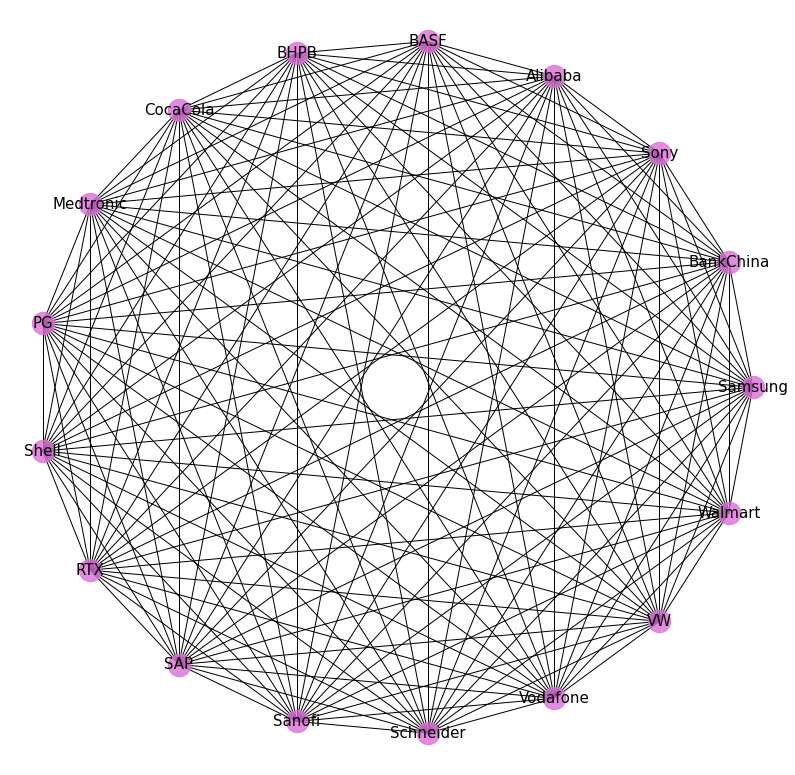

In [17]:
#function to create and display networks from the correlatin matrix. 

def create_corr_network_1(G):
    #crates a list for edges and for the weights
    edges,weights = zip(*nx.get_edge_attributes(G,'weight').items())

    #positions
    positions=nx.circular_layout(G)
    
    #Figure size
    plt.figure(figsize=(14,14))

    #draws nodes
    nx.draw_networkx_nodes(G,positions,node_color='#DA70D6',
                           node_size=500,alpha=0.8)
    
    #Styling for labels
    nx.draw_networkx_labels(G, positions, font_size=15, 
                            font_family='sans-serif')
        
    #draws the edges
    nx.draw_networkx_edges(G, positions)#, edge_list=edges,style='solid')
    
    # displays the graph without axis
    plt.axis('off')
    #saves image
    plt.savefig("network.png", format="PNG")
    plt.show() 

create_corr_network_1(G)

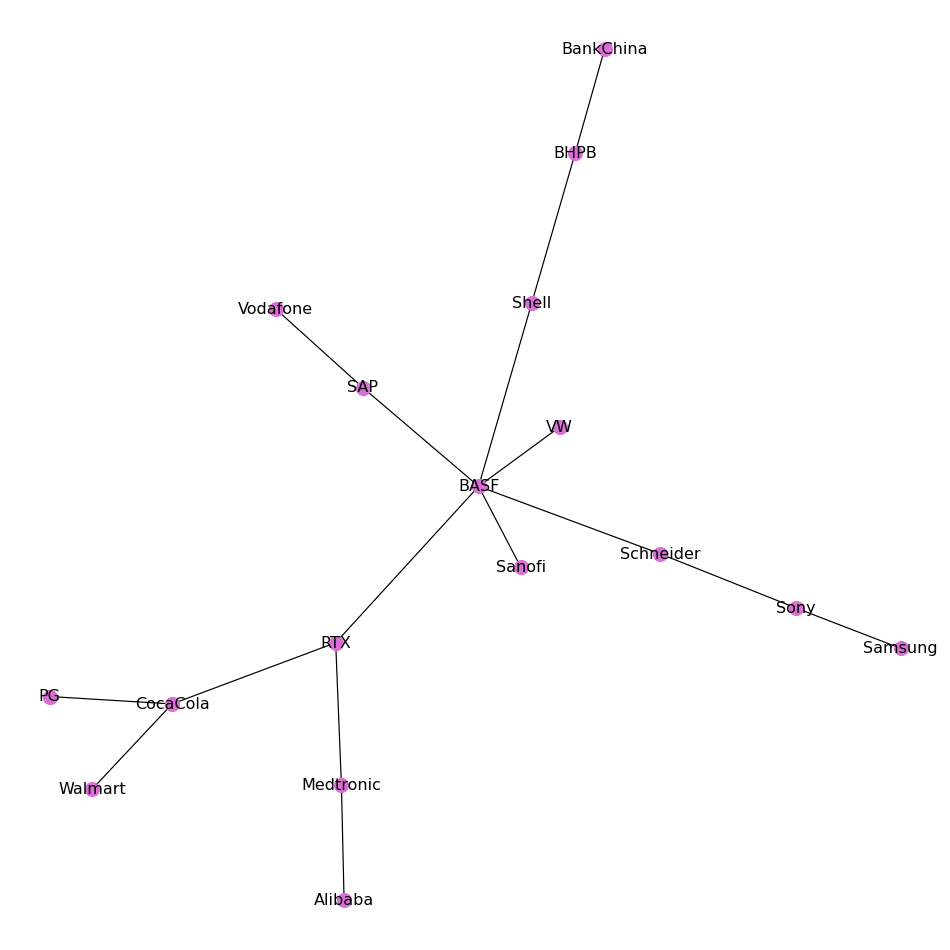

In [16]:
def create_corr_network_1(G):
    #Figure size
    plt.figure(figsize=(13,13))
    
    mst = nx.minimum_spanning_tree(G)

    #draw minimum spanning tree. Set node size and width to constant
    nx.draw(mst, with_labels=True, pos=nx.fruchterman_reingold_layout(mst),
        node_size=200, node_color="#DA70D6", width = 1.2, font_size=16)#, edge_color=edge_colours,
       #width = 1.2)
    
    
    # displays the graph without axis
    plt.axis('off')
    #saves image
    plt.savefig("mst1.png", format="PNG")
    plt.show() 

create_corr_network_1(G)

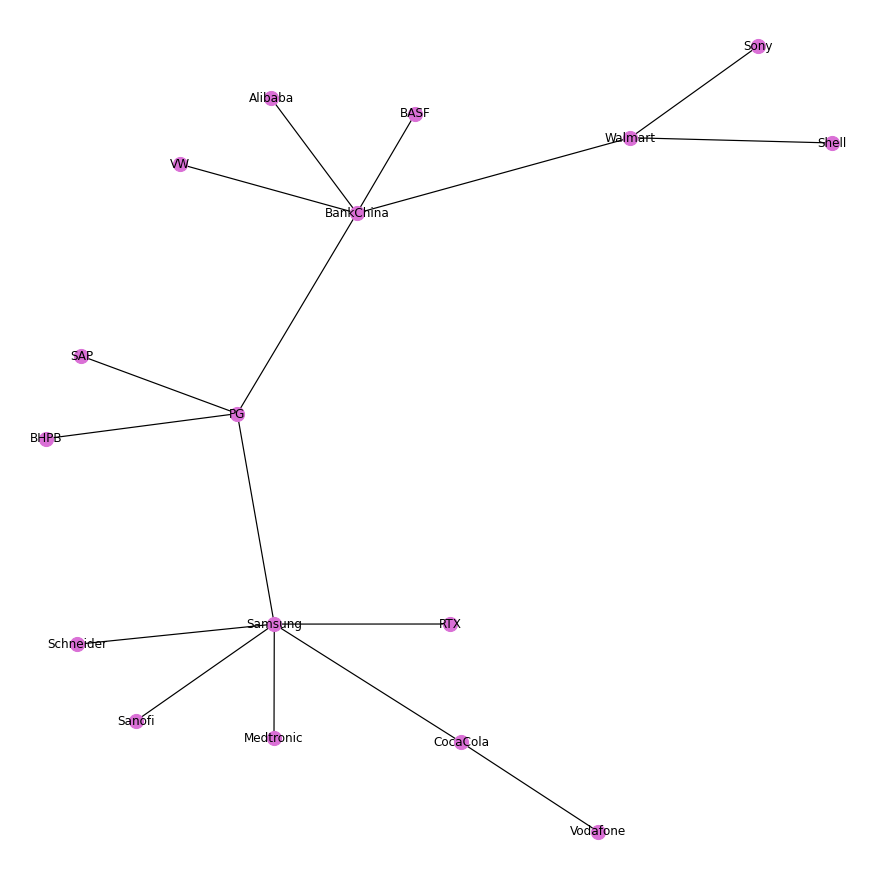

In [17]:
def create_corr_network_1(G):
    #Figure size
    plt.figure(figsize=(12,12))
    
    mst = nx.maximum_spanning_tree(G)

    #draw minimum spanning tree. Set node size and width to constant
    nx.draw(mst, with_labels=True, pos=nx.fruchterman_reingold_layout(mst),
        node_size=200, node_color="#DA70D6", width = 1.2)#, edge_color=edge_colours,
       #width = 1.2)

    
    # displays the graph without axis
    plt.axis('off')
    #saves image
    plt.savefig("mst2.png", format="PNG")
    plt.show() 

create_corr_network_1(G)

In [307]:
df = pd.read_csv('eikon.csv')

In [308]:
df["Date"] = df["Date"].astype('datetime64')

In [309]:
dates = df.Date
dates.to_csv("dates.csv")

In [310]:
df.columns = ["Date", "Samsung", "BankChina", "Sony", "Alibaba", "BASF", "BHPB", "CocaCola", "Medtronic", "PG", "Shell", "RTX", "SAP", "Sanofi", "Schneider", "Vodafone", "VW", "Walmart"] 

In [311]:
train_size = 6832+252

In [312]:
df.set_index('Date', inplace=True)

In [313]:
df = df/df.shift(1)

In [314]:
df = np.log(df)

In [315]:
df = df[-90:]

In [316]:
df = df.fillna(df.mean())

In [328]:
X = df

In [329]:
#X = dist

In [330]:
# pca = PCA(n_components=2)
# components = pca.fit_transform(df)

In [331]:
from pca import pca

In [332]:
pca()

In [333]:
model=pca(n_components=2, normalize=True)

In [334]:
results = model.fit_transform(X)

[pca] >Processing dataframe..
[pca] >Normalizing input data per feature (zero mean and unit variance)..
[pca] >The PCA reduction is performed on the [17] columns of the input dataframe.
[pca] >Fitting using PCA..
[pca] >Computing loadings and PCs..
[pca] >Computing explained variance..
[pca] >Outlier detection using Hotelling T2 test with alpha=[0.05] and n_components=[2]
[pca] >Outlier detection using SPE/DmodX with n_std=[2]


In [335]:
loadings=results['loadings']
loadings

,Samsung,BankChina,Sony,Alibaba,BASF,BHPB,CocaCola,Medtronic,PG,Shell,RTX,SAP,Sanofi,Schneider,Vodafone,VW,Walmart
PC1,-0.141622,-0.023252,-0.235178,-0.079870,-0.301328,-0.305740,-0.286262,-0.360379,-0.269383,-0.240176,-0.302893,-0.245785,-0.151589,-0.289999,-0.209061,-0.134704,-0.265112
PC2,-0.006520,-0.029726,-0.154148,-0.097688,0.374032,0.324051,-0.355401,-0.228854,-0.351728,0.254846,-0.045424,0.100298,-0.349749,0.237482,0.292281,0.167581,-0.221725


In [336]:
scores=results['PC']
#scores['lables']=None
scores

,PC1,PC2
2021-01-06,-3.188290,5.145168
2021-01-07,-0.148387,2.103439
2021-01-08,-2.289560,-1.846841
2021-01-11,1.914071,-0.253856
2021-01-12,0.066073,0.034538
...,...,...
2021-05-05,-2.216953,4.757065
2021-05-06,-1.055120,-0.426612
2021-05-07,-0.169769,0.264302
2021-05-10,-0.585371,-1.578970


In [337]:
label = scores.index
label

DatetimeIndex(['2021-01-06', '2021-01-07', '2021-01-08', '2021-01-11',
               '2021-01-12', '2021-01-13', '2021-01-14', '2021-01-15',
               '2021-01-18', '2021-01-19', '2021-01-20', '2021-01-21',
               '2021-01-22', '2021-01-25', '2021-01-26', '2021-01-27',
               '2021-01-28', '2021-01-29', '2021-02-01', '2021-02-02',
               '2021-02-03', '2021-02-04', '2021-02-05', '2021-02-08',
               '2021-02-09', '2021-02-10', '2021-02-11', '2021-02-12',
               '2021-02-15', '2021-02-16', '2021-02-17', '2021-02-18',
               '2021-02-19', '2021-02-22', '2021-02-23', '2021-02-24',
               '2021-02-25', '2021-02-26', '2021-03-01', '2021-03-02',
               '2021-03-03', '2021-03-04', '2021-03-05', '2021-03-08',
               '2021-03-09', '2021-03-10', '2021-03-11', '2021-03-12',
               '2021-03-15', '2021-03-16', '2021-03-17', '2021-03-18',
               '2021-03-19', '2021-03-22', '2021-03-23', '2021-03-24',
      

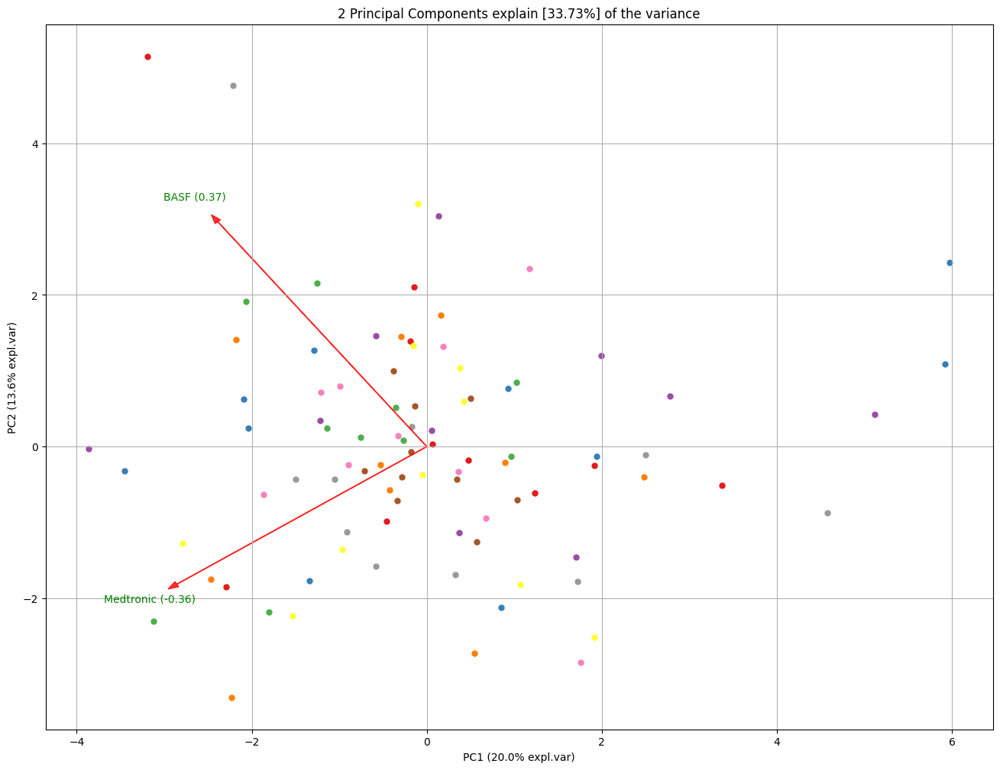

In [340]:
model.biplot(n_feat=2,  legend=False, figsize=(16,12), y=None, label=False)
plt.show()